# Cinema Audience Forecasting challenge

In [1]:
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/Cinema_Audience_Forecasting_challenge/movie_theater_id_relation/movie_theater_id_relation.csv
/kaggle/input/Cinema_Audience_Forecasting_challenge/date_info/date_info.csv
/kaggle/input/Cinema_Audience_Forecasting_challenge/sample_submission/sample_submission.csv
/kaggle/input/Cinema_Audience_Forecasting_challenge/booknow_theaters/booknow_theaters.csv
/kaggle/input/Cinema_Audience_Forecasting_challenge/cinePOS_booking/cinePOS_booking.csv
/kaggle/input/Cinema_Audience_Forecasting_challenge/cinePOS_theaters/cinePOS_theaters.csv
/kaggle/input/Cinema_Audience_Forecasting_challenge/booknow_visits/booknow_visits.csv
/kaggle/input/Cinema_Audience_Forecasting_challenge/booknow_booking/booknow_booking.csv


# Import Libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

# 1 Data loading and inspection

## 1.1. Load all Datasets: 

In [3]:
df_movie_theater_id_relation = pd.read_csv('/kaggle/input/Cinema_Audience_Forecasting_challenge/movie_theater_id_relation/movie_theater_id_relation.csv')
df_date_info = pd.read_csv('/kaggle/input/Cinema_Audience_Forecasting_challenge/date_info/date_info.csv')
df_sample_submission = pd.read_csv('/kaggle/input/Cinema_Audience_Forecasting_challenge/sample_submission/sample_submission.csv')
df_booknow_theaters = pd.read_csv('/kaggle/input/Cinema_Audience_Forecasting_challenge/booknow_theaters/booknow_theaters.csv')
df_cinePOS_booking = pd.read_csv('/kaggle/input/Cinema_Audience_Forecasting_challenge/cinePOS_booking/cinePOS_booking.csv')
df_cinePOS_theaters = pd.read_csv('/kaggle/input/Cinema_Audience_Forecasting_challenge/cinePOS_theaters/cinePOS_theaters.csv')
df_booknow_visits = pd.read_csv('/kaggle/input/Cinema_Audience_Forecasting_challenge/booknow_visits/booknow_visits.csv')
df_booknow_booking = pd.read_csv('/kaggle/input/Cinema_Audience_Forecasting_challenge/booknow_booking/booknow_booking.csv')
df_sample = pd.read_csv('/kaggle/input/Cinema_Audience_Forecasting_challenge/sample_submission/sample_submission.csv')

## 1.2. Data Understanding & Merging Map

### df_booknow_booking :

In [4]:
df_booknow_booking.head()

,book_theater_id,show_datetime,booking_datetime,tickets_booked
0,book_00244,2023-01-01 19:00:00,2023-01-01 16:00:00,1
1,book_00740,2023-01-01 19:00:00,2023-01-01 19:00:00,3
2,book_00740,2023-01-01 19:00:00,2023-01-01 19:00:00,6
3,book_00244,2023-01-01 20:00:00,2023-01-01 16:00:00,2
4,book_00151,2023-01-01 20:00:00,2023-01-01 01:00:00,5


In [5]:
df_booknow_booking.describe()

,tickets_booked
count,68336.000000
mean,4.425808
std,4.808945
min,1.000000
25%,2.000000
50%,3.000000
75%,5.000000
max,100.000000


In [6]:
df_booknow_booking.shape

(68336, 4)

In [7]:
df_booknow_booking.isna().sum()

book_theater_id     0
show_datetime       0
booking_datetime    0
tickets_booked      0
dtype: int64

In [8]:
df_booknow_booking.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68336 entries, 0 to 68335
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   book_theater_id   68336 non-null  object
 1   show_datetime     68336 non-null  object
 2   booking_datetime  68336 non-null  object
 3   tickets_booked    68336 non-null  int64 
dtypes: int64(1), object(3)
memory usage: 2.1+ MB


### df_booknow_theaters

In [9]:
df_booknow_theaters.head(2)

,book_theater_id,theater_type,theater_area,latitude,longitude
0,book_00093,Drama,Area_001,22.619233,78.113017
1,book_00078,Drama,Area_001,22.619233,78.113017


In [10]:
df_booknow_theaters.shape

(829, 5)

In [11]:
df_booknow_theaters.isna().sum()

book_theater_id    515
theater_type         0
theater_area         0
latitude             0
longitude            0
dtype: int64

In [12]:
df_booknow_theaters.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 829 entries, 0 to 828
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   book_theater_id  314 non-null    object 
 1   theater_type     829 non-null    object 
 2   theater_area     829 non-null    object 
 3   latitude         829 non-null    float64
 4   longitude        829 non-null    float64
dtypes: float64(2), object(3)
memory usage: 32.5+ KB


In [13]:

df_booknow_theaters.theater_type.value_counts()

theater_type
Other     411
Comedy    196
Drama     183
Action     39
Name: count, dtype: int64

In [14]:
df_booknow_theaters['book_theater_id'].nunique()

314

### df_booknow_visits

In [15]:
df_booknow_visits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 214046 entries, 0 to 214045
Data columns (total 3 columns):
 #   Column           Non-Null Count   Dtype 
---  ------           --------------   ----- 
 0   book_theater_id  214046 non-null  object
 1   show_date        214046 non-null  object
 2   audience_count   214046 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 4.9+ MB


In [16]:
df_booknow_visits.head(2)

,book_theater_id,show_date,audience_count
0,book_00001,2023-01-13,50
1,book_00001,2023-01-14,64


In [17]:
df_booknow_visits.shape

(214046, 3)

In [18]:
df_booknow_visits.isna().sum()

book_theater_id    0
show_date          0
audience_count     0
dtype: int64

In [19]:
df_booknow_visits.describe()

,audience_count
count,214046.000000
mean,41.616568
std,32.834918
min,2.000000
25%,18.000000
50%,34.000000
75%,58.000000
max,1350.000000


In [20]:
df_booknow_visits['book_theater_id'].nunique()

826

### df_cinePOS_booking

In [21]:
df_cinePOS_booking.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1641966 entries, 0 to 1641965
Data columns (total 4 columns):
 #   Column            Non-Null Count    Dtype 
---  ------            --------------    ----- 
 0   cine_theater_id   1641966 non-null  object
 1   show_datetime     1641966 non-null  object
 2   booking_datetime  1641966 non-null  object
 3   tickets_sold      1641966 non-null  int64 
dtypes: int64(1), object(3)
memory usage: 50.1+ MB


In [22]:
df_cinePOS_booking.head(2)

,cine_theater_id,show_datetime,booking_datetime,tickets_sold
0,cinePOS_00001,2023-01-01 11:00:00,2023-01-01 09:00:00,1
1,cinePOS_00002,2023-01-01 13:00:00,2023-01-01 06:00:00,3


In [23]:
df_cinePOS_booking.shape

(1641966, 4)

In [24]:
df_cinePOS_booking.isna().sum()

cine_theater_id     0
show_datetime       0
booking_datetime    0
tickets_sold        0
dtype: int64

In [25]:
df_cinePOS_booking.cine_theater_id.unique().shape

(13161,)

### df_cinePOS_theaters

In [26]:
df_cinePOS_theaters.head(2)

,cine_theater_id,theater_type,theater_area,latitude,longitude
0,cinePOS_05466,Other,Area_104,22.619233,78.113017
1,cinePOS_08708,Other,Area_104,22.619233,78.113017


In [27]:
df_cinePOS_theaters.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4690 entries, 0 to 4689
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   cine_theater_id  4690 non-null   object 
 1   theater_type     4690 non-null   object 
 2   theater_area     4690 non-null   object 
 3   latitude         829 non-null    float64
 4   longitude        829 non-null    float64
dtypes: float64(2), object(3)
memory usage: 183.3+ KB


In [28]:
df_cinePOS_theaters.shape

(4690, 5)

In [29]:
df_cinePOS_theaters.describe(include='number')

,latitude,longitude
count,829.000000,829.000000
mean,23.000000,79.000000
std,0.833863,1.460388
min,22.025970,76.112098
25%,22.619233,78.170501
50%,23.004410,79.908065
75%,23.018784,79.934515
max,26.349436,81.743235


In [30]:
df_cinePOS_theaters['cine_theater_id'].nunique()

4690

In [31]:
df_cinePOS_theaters.isna().sum()

cine_theater_id       0
theater_type          0
theater_area          0
latitude           3861
longitude          3861
dtype: int64

In [32]:
df_cinePOS_theaters['theater_type'].value_counts()

theater_type
Other     3941
Drama      705
Action      44
Name: count, dtype: int64

#### df_date_info

In [33]:
df_date_info.head(2)

,show_date,day_of_week
0,2023-01-01,Sunday
1,2023-01-02,Monday


In [34]:
df_date_info.shape

(547, 2)

In [35]:
df_date_info.isna().sum()

show_date      0
day_of_week    0
dtype: int64

In [36]:
df_date_info.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 547 entries, 0 to 546
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   show_date    547 non-null    object
 1   day_of_week  547 non-null    object
dtypes: object(2)
memory usage: 8.7+ KB


### df_movie_theater_id_relation

In [37]:
df_movie_theater_id_relation.head(2)

,book_theater_id,cine_theater_id
0,book_00509,cinePOS_01261
1,book_00063,cinePOS_02467


In [38]:
df_movie_theater_id_relation.shape

(150, 2)

In [39]:
df_movie_theater_id_relation.isna().sum()

book_theater_id    0
cine_theater_id    0
dtype: int64

In [40]:
df_movie_theater_id_relation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 2 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   book_theater_id  150 non-null    object
 1   cine_theater_id  150 non-null    object
dtypes: object(2)
memory usage: 2.5+ KB


# Project Milestones

## Project Milestone 1

In [41]:
# print('Q1')
# df_booknow_booking.shape

In [42]:
#print('Q2')
# df_booknow_booking['booking_datetime'] = pd.to_datetime(df_booknow_booking['booking_datetime'], errors='coerce')

# start_date = df_booknow_booking['booking_datetime'].min()
# end_date = df_booknow_booking['booking_datetime'].max()


# date_range = f"{start_date.strftime('%d-%m-%Y')} to {end_date.strftime('%d-%m-%Y')}"
# print(date_range)




In [43]:
# print('Q3')
# df_booknow_theaters.theater_type.hist()


In [44]:
# print('Q4')
# df_cinePOS_booking.cine_theater_id.unique().shape

In [45]:
# merged = pd.merge(df_booknow_booking,df_booknow_theaters,on='book_theater_id')

In [46]:
# print('Q5')
# merged = pd.merge(df_booknow_booking,df_booknow_theaters,on='book_theater_id')

# merged.shape

In [47]:
# print('Q6')
# merged.theater_area.unique().shape

In [48]:
# print('Q7')
# cine.isna().sum()

In [49]:
# print('Q8')
# df_booknow_booking['booking_datetime'] = pd.to_datetime(df_booknow_booking['booking_datetime'], errors='coerce')


# start = df_booknow_booking['booking_datetime'].min()
# end = df_booknow_booking['booking_datetime'].max()


# date_range = f"{start.strftime('%d-%m-%Y')} to {end.strftime('%d-%m-%Y')}"
# print(date_range)


In [50]:
# print('Q9')

# df_sample[['book_theater_id', 'show_date']] = df_sample['ID'].str.extract(r'(book_\d+)_(\d{4}-\d{2}-\d{2})')
# df_sample['show_date'] = pd.to_datetime(df_sample['show_date']).dt.date

# start = df_sample['show_date'].min()
# end = df_sample['show_date'].max()


# date_range = f"{start.strftime('%d-%m-%Y')} to {end.strftime('%d-%m-%Y')}"
# print(date_range)

## Project Milestone 2

Q1.  In the booknow_booking.csv file, how many total booking records (rows) were made on the same calendar day as the show's date?
    Note: The question refers to day / date and not datetime

Q2.  How many unique calendar months (e.g., Jan 2023, Feb 2023, ...) are present in the show_date column of the date_info.csv file?

Q3.  What percentage of bookings in booknow_booking.csv were made on a Sunday?

Q4.  In the booknow_theaters.csv file, if you decided to impute any missing latitude values by the mean latitude of all the theaters with theater_type equal to Drama, what would be the imputed value (rounded to 5 decimal places)?

Q5.  What is the range (Maximum - Minimum) of the latitude column in the booknow_theaters.csv file (rounded to 4 decimal places)?

Q6.  To handle potential outliers in ticket sales, you decide to cap the tickets_sold column in cinePOS_booking.csv at the 95 th percentile. Enter that value.

Q7.  Apply OneHot Encoding on all the categorical columns of the dataset cinePOS_theaters.csv. What is the shape of the dataset after applying this transformation?
    Note: The result obtained highlights a potential drawback of OneHot encoding. Read about other forms of encoding and the advantages / disadvantages they offer.

In [51]:
# df_m2 = df_booknow_booking

# df_m2

In [52]:
# df_m2['show_date'] = pd.to_datetime(df_m2['show_datetime']).dt.date
# df_m2['month'] = pd.to_datetime(df_m2['show_date']).dt.month_name()
# df_m2['day'] = pd.to_datetime(df_m2['show_date']).dt.day_name()

In [53]:
# df_m2['show_date'].unique().shape[0]

Q2 How many unique calendar months (e.g., Jan 2023, Feb 2023, ...) are present in the show_date column of the date_info.csv file?

In [54]:
# df_m2['month'].unique().shape[0]

Q3 What percentage of bookings in booknow_booking.csv were made on a Sunday?

In [55]:
# arr = df_m2['day'].value_counts().values

# arr = arr/arr.sum()

In [56]:
# arr*100

## Project Milestone 3

For this milestone, only the booknow_visits.csv file is to be used. Using the show_date column, create new columns for day, month, year and dayofyear. Once the new columns are created, drop the show_date column.

Split the data into X & y with the target variable audience_count as y and the remaining features as X.

Split the dataset so that 20% of it is kept for validation. Ensure the split preserves the time series nature of the dataset. This data will be referred to as X_train, X_test and y_train, y_test.

In [57]:
# df_m3 = df_booknow_visits

# df_m3

In [58]:
# df_m3['day'] = pd.to_datetime(df_m3['show_date']).dt.day  
# df_m3['month'] = pd.to_datetime(df_m3['show_date']).dt.month
# df_m3['year'] = pd.to_datetime(df_m3['show_date']).dt.year           
# df_m3['dayofyear'] = pd.to_datetime(df_m3['show_date']).dt.dayofyear 
# df_m3 = df_m3.drop('show_date',axis=1)

In [59]:
# df_m3

In [60]:
# X = df_m3.drop('audience_count',axis=1)
# y = df_m3['audience_count']

In [61]:
# y.hist(bins=1000)

Q1.  What is the shape of X_train after making the said changes?
    Note: If the dataset has x rows & y columns, enter your answer as (x,y)

In [62]:
# from sklearn.model_selection import train_test_split

# X_train, X_test, y_train, y_test = train_test_split(
#     X, y, test_size=0.2, random_state=42,shuffle=False
# )

# print("Train shape:", X_train.shape)
# print("Test shape:", X_test.shape)


Use MinMaxScaler for the numerical columns & OneHotEncoding for the categorical columns. These transformations are to be applied on both the train & test datasets. Answer all the questions that follow.

Q2.  Use LinearSVR` for training and enter the r2_score obtained on the test dataset. (Upto 3 decimal places)

In [63]:
# import pandas as pd
# from sklearn.model_selection import train_test_split
# from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
# from sklearn.compose import ColumnTransformer
# from sklearn.pipeline import Pipeline
# from sklearn.svm import LinearSVR
# from sklearn.decomposition import TruncatedSVD
# from sklearn.metrics import r2_score, mean_absolute_error

In [64]:
# num_cols = X.select_dtypes(include=['int64', 'float64']).columns
# cat_cols = X.select_dtypes(include=['object', 'category']).columns

In [65]:
# # --- Preprocessing: Scaling and Encoding ---
# num_cols = ['day', 'month', 'year', 'dayofyear']
# cat_fcols = ['book_theater_id']

In [66]:
# preprocessor = ColumnTransformer([
#     ('num', MinMaxScaler(), num_cols),
#     ('cat', OneHotEncoder(handle_unknown='ignore'), cat_cols)
# ])

In [67]:
# X

In [68]:
# model1 = Pipeline([
#     ('preprocessor', preprocessor),
#     ('svr', LinearSVR(random_state=42, max_iter=10000))
# ])

# model1.fit(X_train, y_train)
# y_pred_test = model1.predict(X_test)
# r2_test_1 = r2_score(y_test, y_pred_test)

# print("R² Score on Test Data :", round(r2_test_1, 3))

Q3. Use TruncatedSVD with n_components = 4 and train LinearSVR again. What is the mean_absolute_error obtained on the training data? (Upto 3 decimal places)

Q4. Based on the previous question, what is the r2_score obtained on the test data? (Upto 3 decimal places)

In [69]:
# model2 = Pipeline([
#     ('preprocessor', preprocessor),
#     ('svd', TruncatedSVD(n_components=4)),
#     ('svr', LinearSVR(random_state=42, max_iter=10000))
# ])

# model2.fit(X_train, y_train)
# y_pred_train = model2.predict(X_train)
# y_pred_test = model2.predict(X_test)

# mae_train_2 = mean_absolute_error(y_train, y_pred_train)
# r2_test_2 = r2_score(y_test, y_pred_test)

# print("Mean Absolute Error on Train Data (with SVD):", round(mae_train_2, 3))
# print("R² Score on Test Data with SVD:", round(r2_test_2, 3))

Q5. Use SelectKBest with k = 2, score_func = mutual_info_regression. Based on attributes output by SelectKBest, what is the maximum score obtained?

Q6. Based on the previous question, what is the mean value of scores?

In [70]:
# from sklearn.feature_selection import SelectKBest, mutual_info_regression
# pipeline = Pipeline([
#     ('preprocessor', preprocessor),
#     ('selector', SelectKBest(score_func=mutual_info_regression, k=2))
# ])

In [71]:
# pipeline.fit(X_train, y_train)


# selector = pipeline.named_steps['selector']
# scores = selector.scores_

# max_score = scores.max()
# mean_score = scores.mean()

# print("Maximum score obtained:", round(max_score, 3))
# print("Mean of all scores:", round(mean_score, 3))

## Project Milestone 4

For this milestone, only the booknow_visits.csv file is to be used. Using the show_date column, create new columns for day, month, year and dayofyear. Once the new columns are created, drop the show_date column.

Split the data into X & y with the target variable audience_count as y and the remaining features as X. 

Split the dataset so that 20% of it is kept for validation. Ensure the split preserves the time series nature of the dataset. This data will be referred to as X_train, X_test and y_train, y_test.

Use MinMaxScaler for the numerical columns & OneHotEncoding for the categorical columns. These transformations are to be applied on both the train & test datasets. Answer all the questions that follow.





Q1. Train the DecisionTreeRegressor with default parameters on X_train.  
   What is the r2_score obtained on X_train? (upto 3 decimal places)

Q2. Use the model trained in the previous question to predict for X_test.  
   What is the r2_score obtained on X_test? (upto 3 decimal places)

In [72]:
# from sklearn.tree import DecisionTreeRegressor



# model = Pipeline([
#     ('preprocessor', preprocessor),
#     ('dtr', DecisionTreeRegressor(random_state=42))
# ])

# model.fit(X_train, y_train)

# # R² score on training data
# y_pred_train = model.predict(X_train)
# r2_train_2 = r2_score(y_train, y_pred_train)
# print("R² Score on Train Data :", round(r2_train_2, 3))

# # R² score on test data
# y_pred_test = model.predict(X_test)
# r2_test_2 = r2_score(y_test, y_pred_test)
# print("R² Score on Test Data :", round(r2_test_2, 3))


3. Perform Hyper Parameter Tuning for the Decision Tree model.  
   Set random_state = 42 and use TimeSeriesSplit with n_splits = 5 for cross validation.

   Hyperparameter tuning is to be done over the following:
   - max_dept` as [None, 3, 5, 10]
   - min_samples_split as [2, 5, 10]
   - min_samples_leaf as [1, 2, 4]

   Paste the output obtained when printing the best_params_.



In [73]:
# from sklearn.model_selection import GridSearchCV, TimeSeriesSplit


# param_grid = {
#     'dtr__max_depth': [None, 3, 5, 10],
#     'dtr__min_samples_split': [2, 5, 10],
#     'dtr__min_samples_leaf': [1, 2, 4]
# }


# tscv = TimeSeriesSplit(n_splits=5)

# dt = Pipeline([
#     ('preprocessor', preprocessor),
#     ('dtr', DecisionTreeRegressor(random_state=42))
# ])

# grid_search = GridSearchCV(dt, param_grid, cv=tscv, scoring='r2')
# grid_search.fit(X_train, y_train)


# print("Best Parameters:", grid_search.best_params_)


Q4. Train the BaggingRegressor model with default parameters on X_train.  
   What is the RMSE obtained on X_train? (upto 3 decimal places)

In [74]:
# from sklearn.ensemble import BaggingRegressor
# from sklearn.metrics import mean_squared_error
# import numpy as np


# bag_model = Pipeline([
#     ('preprocessor', preprocessor),
#     ('bg', BaggingRegressor(random_state=42))
# ])

# bag_model.fit(X_train, y_train)


# y_pred_train = bag_model.predict(X_train)


# rmse_train = np.sqrt(mean_squared_error(y_train, y_pred_train))
# print("RMSE on Train Data :", round(rmse_train, 3))

Q5. Use the model trained in the previous question to predict for X_test.  
   What is the RMSE obtained on X_test ? (upto 3 decimal places)



In [75]:

# y_pred_test = bag_model.predict(X_test)


# rmse_test = np.sqrt(mean_squared_error(y_test, y_pred_test))
# print("RMSE on Test Data :", round(rmse_test, 3))

Q6. Perform Hyper Parameter Tuning for the BaggingRegressor model.  
   Set random_state = 42 and use TimeSeriesSplit with n_splits = 5 for cross validation.

   Hyperparameter tuning is to be done over the following:
   - n_estimators as [10, 50, 100]
   - max_samples as [0.5, 0.7, 1.0]
   - max_features as [0.5, 0.8, 1.0]

   What is the value of the best_score_ obtained after the hyperparameter tuning is completed? (upto 3 decimal places)



In [76]:
# from sklearn.ensemble import BaggingRegressor


# param_grid = {
#     'bg__n_estimators': [10, 50, 100],
#     'bg__max_samples': [0.5, 0.7, 1.0],
#     'bg__max_features': [0.5, 0.8, 1.0]
# }


# tscv = TimeSeriesSplit(n_splits=5)


# bag_model = Pipeline([
#     ('preprocessor', preprocessor),
#     ('bg', BaggingRegressor(random_state=42))
# ])


# grid_search_bag = GridSearchCV(bag_model, param_grid, cv=tscv, scoring='r2')
# grid_search_bag.fit(X_train, y_train)


# print("Best Parameters:", grid_search_bag.best_params_)
# print("Best Score:", round(grid_search_bag.best_score_, 3))


Q7. Train the GradientBoostingRegressor model with default parameters on X_train.  
   What is the mean absolute error obtained on X_train?

Q8. Use the model trained in the previous question to predict for X_test  
   What is the mean absolute error obtained on X_test? (upto 3 decimal places)

In [77]:
# from sklearn.ensemble import GradientBoostingRegressor
# from sklearn.metrics import mean_absolute_error



# gbr = Pipeline([
#     ('preprocessor', preprocessor),
#     ('gb', GradientBoostingRegressor(random_state=42))
# ])


# gbr.fit(X_train, y_train)


# y_pred_train = gbr.predict(X_train)


# mae_train = mean_absolute_error(y_train, y_pred_train)
# print("Mean Absolute Error on Train Data :", round(mae_train, 3))


In [78]:

# y_pred_test = gbr.predict(X_test)

# mae_test = mean_absolute_error(y_test, y_pred_test)
# print("Mean Absolute Error on Test Data :", round(mae_test, 3))

## Project Milestone 5

Load the file booknow_booking.csv. Extract the date part from show_datetime as a new column show_date.

In [79]:
# df1= df_booknow_booking

Q 1. Group the data by book_theater_id and show_date, and calculate the total number of tickets booked per theater per day
What is the shape of the resulting dataset (number of rows, columns)?

In [80]:
# df1['show_date'] = pd.to_datetime(df1['show_datetime']).dt.date
# grouped = df1.groupby(['book_theater_id', 'show_date'])
# booknow_agg = grouped['tickets_booked'].sum().reset_index()
# booknow_agg.shape

2. Load the file cinePOS_booking.csv. Extract show_date from show_datetime.
Group the data by cine_theater_id and show_date, summing the total tickets_sold.

After aggregation, what is the shape of the resulting dataset?

In [81]:
# df2= df_cinePOS_booking
# df2['show_date'] = pd.to_datetime(df2['show_datetime']).dt.date
# grouped = df.groupby(['cine_theater_id', 'show_date'])
# cinepos_agg = grouped['tickets_sold'].sum().reset_index()
# cinepos_agg.shape

Q 3. Merge the BookNow and CinePOS aggregated datasets (from previous questions) on book_theater_id and show_date using an outer join, with the help of movie_theater_id_relation.csv.


In [82]:
# cinepos = pd.merge(cinepos_agg,df_movie_theater_id_relation,on='cine_theater_id',how='left')

In [83]:
# cinepos

In [84]:
# combined = pd.merge(cinepos[['book_theater_id', 'show_date', 'tickets_sold']],booknow_agg,on=['book_theater_id', 'show_date'],how='outer')
# combined.shape

Q 4. Merge the combined booking dataset with the BookNow visits file (booknow_visits.csv), which contains the target column audience_count.
Create a new feature that stores the previous day’s audience count for each theater.

After creating the one-day lag feature, how many missing values are introduced in this new column?

In [85]:
# df_booknow_visits['show_date'] = pd.to_datetime(df_booknow_visits['show_date'])
# combined['show_date'] = pd.to_datetime(merged['show_date'])

In [86]:
# merged = pd.merge(combined,df_booknow_visits,on=['book_theater_id','show_date'],how='outer')

In [87]:
# # Ensure data is sorted by theater and date
# merged = merged.sort_values(['book_theater_id', 'show_date'])
# merged['lag_1'] = merged.groupby('book_theater_id')['audience_count'].shift(1)


In [88]:
# merged.isna().sum()

In [89]:
# from statsmodels.tsa.stattools import adfuller
# from statsmodels.tsa.arima.model import ARIMA
# from sklearn.metrics import r2_score

Q 5. Select the theater ID 'book_00001' and perform the Augmented Dickey-Fuller (ADF) test.
What is the p-value?

In [90]:
# adf_series = merged[merged['book_theater_id'] == 'book_00001']
# adf_series = adf_series.set_index('show_date')['audience_count'].sort_index()

# adf_result = adfuller(adf_series)
# p_value = adf_result[1]
# print(f"ADF Test p-value for 'book_00001': {p_value:.6f}")


Q 6. Based on the p-value, what can you conclude about the stationarity of the time series?

Q 7. What is the AIC value of the fitted model?

In [91]:
# # Split the adf_series (last 30 days for test)
# train_data = adf_series.iloc[:-30]
# test_data = adf_series.iloc[-30:]
# print(f"Records in the training set: {len(train_data)}")

Q 8. What is the value of parameter d used for differencing?


In [92]:
# print("The 'd' parameter for ARIMA(1,1,1) is: 1")

Q 9. What is the AIC value of the fitted model?

In [93]:
# model = ARIMA(train_data, order=(1, 1, 1))
# model_fit = model.fit()
# print(f"AIC value of the fitted model: {model_fit.aic:.3f}")

Q 10. What is the R² score obtained for the test data?

In [94]:
# predictions = model_fit.forecast(steps=len(test_data))

# r2 = r2_score(test_data, predictions)
# print(f"R² score on the test data: {r2:.3f}")

# 2. Exploratory Data Analysis (EDA)

In [95]:
# Convert 'show_datetime' to proper date in df_booknow_booking/df_cinePOS_booking/df_booknow_visits/df_date_info dataset
# Because merging, grouping works well only if the column is in proper datetime/date type, not string

df_booknow_booking['show_date'] = pd.to_datetime(df_booknow_booking['show_datetime']).dt.date
df_cinePOS_booking['show_date'] = pd.to_datetime(df_cinePOS_booking['show_datetime']).dt.date
df_booknow_visits['show_date'] = pd.to_datetime(df_booknow_visits['show_date']).dt.date
df_date_info['show_date'] = pd.to_datetime(df_date_info['show_date']).dt.date

## Booknow dataset EDA

In [96]:
# Aggregate total tickets booked per theater per date
daily_booknow_agg = df_booknow_booking.groupby(['book_theater_id', 'show_date'])['tickets_booked'].sum().reset_index()

In [97]:
# 1. Merge aggregated BookNow booking data
# merge daily_booknow_agg(tickets_booked) with df_booknow_visits
df_1 = pd.merge(
    df_booknow_visits,
    daily_booknow_agg,
    on=['book_theater_id', 'show_date'],
    how='left'
)


#  merge theater metadata theater_type/area/lat/long.
df_2 = pd.merge(
    df_1,
    df_booknow_theaters,
    on='book_theater_id',
    how='left'
)


#  Merge calendar info day_of
df_booknow = pd.merge(
    df_2,
    df_date_info,
    on='show_date',
    how='left'
)

In [98]:
df_booknow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 214046 entries, 0 to 214045
Data columns (total 9 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   book_theater_id  214046 non-null  object 
 1   show_date        214046 non-null  object 
 2   audience_count   214046 non-null  int64  
 3   tickets_booked   21041 non-null   float64
 4   theater_type     80150 non-null   object 
 5   theater_area     80150 non-null   object 
 6   latitude         80150 non-null   float64
 7   longitude        80150 non-null   float64
 8   day_of_week      214046 non-null  object 
dtypes: float64(3), int64(1), object(5)
memory usage: 14.7+ MB


In [99]:
df_booknow.head(5)

,book_theater_id,show_date,audience_count,tickets_booked,theater_type,theater_area,latitude,longitude,day_of_week
0,book_00001,2023-01-13,50,NaN,Drama,Area_002,23.00441,79.934515,Friday
1,book_00001,2023-01-14,64,NaN,Drama,Area_002,23.00441,79.934515,Saturday
2,book_00001,2023-01-15,58,NaN,Drama,Area_002,23.00441,79.934515,Sunday
3,book_00001,2023-01-16,44,NaN,Drama,Area_002,23.00441,79.934515,Monday
4,book_00001,2023-01-18,12,NaN,Drama,Area_002,23.00441,79.934515,Wednesday


In [100]:
df_booknow.describe()

,audience_count,tickets_booked,latitude,longitude
count,214046.000000,21041.000000,80150.000000,80150.000000
mean,41.616568,13.675776,23.108170,78.936323
std,32.834918,18.599312,1.019523,1.490336
min,2.000000,1.000000,22.025970,76.173250
25%,18.000000,5.000000,22.613688,77.970347
50%,34.000000,10.000000,23.004410,79.895175
75%,58.000000,18.000000,23.018784,79.935314
max,1350.000000,1633.000000,26.349436,81.743235


In [101]:
df_booknow.isna().sum()

book_theater_id         0
show_date               0
audience_count          0
tickets_booked     193005
theater_type       133896
theater_area       133896
latitude           133896
longitude          133896
day_of_week             0
dtype: int64

In [102]:
# descriptive statistics for each theater's audience data
theater_summary = (
    df_booknow.groupby('book_theater_id')['audience_count']
    .agg(
        total_audience='sum',
        avg_audience='mean',
        min_audience='min',
        max_audience='max',
        std_audience='std'
    )
    .reset_index()
)

theater_summary


,book_theater_id,total_audience,avg_audience,min_audience,max_audience,std_audience
0,book_00001,16094,47.058480,2,122,23.388397
1,book_00002,4038,14.020833,2,100,15.039538
2,book_00003,13684,57.016667,4,132,21.138311
3,book_00004,7498,20.486339,2,86,10.598195
4,book_00005,12810,52.716049,2,134,21.389675
...,...,...,...,...,...,...
821,book_00825,19948,83.116667,18,178,30.173053
822,book_00826,12108,30.194514,2,100,14.418463
823,book_00827,5812,17.195266,2,54,10.066413
824,book_00828,7330,24.515050,2,64,12.301127


### Booknow visuals

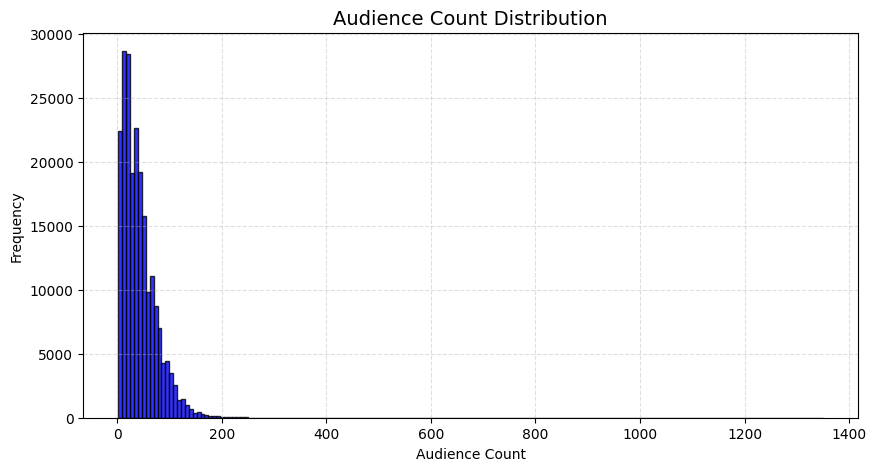

In [103]:
# Plot the distribution of audience counts to observe skewness and ranges

plt.figure(figsize=(10,5))
plt.hist(df_booknow.audience_count, bins=180, color='blue', edgecolor='black', alpha=0.8)

plt.title("Audience Count Distribution", fontsize=14)
plt.xlabel("Audience Count")
plt.ylabel("Frequency")
plt.grid(True, linestyle='--', alpha=0.4)

plt.show()


Insight :

The distribution is strongly right-skewed

Most audience counts are low are between 0–100


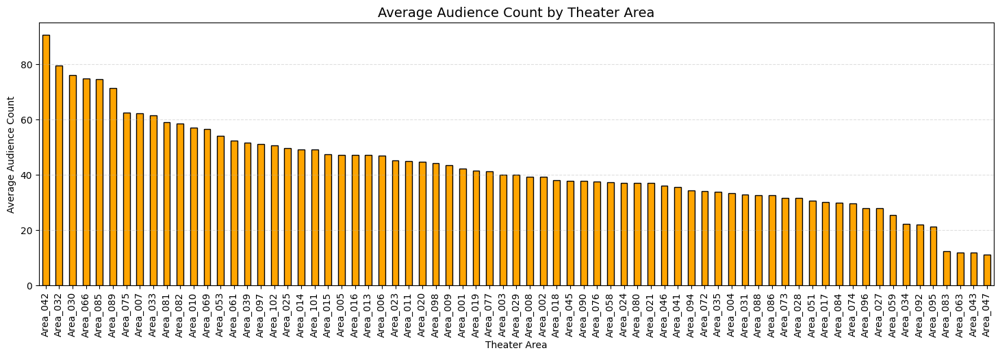

In [104]:
# plot the average audience count for each theater area

plt.figure(figsize=(18,5))
df_booknow.groupby('theater_area')['audience_count'] \
          .mean().sort_values(ascending=False) \
          .plot(kind='bar', color='orange', edgecolor='black')

plt.title("Average Audience Count by Theater Area", fontsize=14)
plt.xlabel("Theater Area")
plt.ylabel("Average Audience Count")
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()


Insights:

Areas like Area_042, Area_032, Area_030, Area_066 have the highest average audiences, meaning they consistently attract more audience.

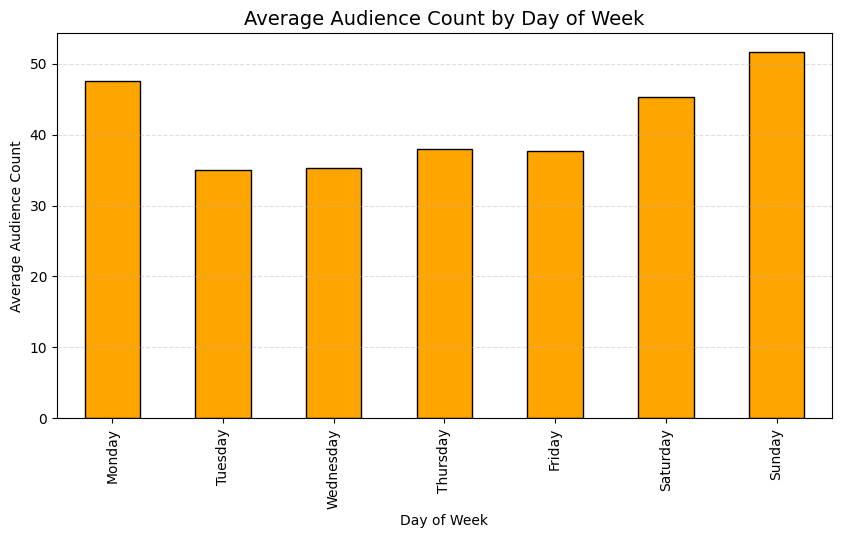

In [105]:
# Plot average audience count for each day of the week to find busy days


days_order = ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]

plt.figure(figsize=(10,5))
df_booknow.groupby('day_of_week')['audience_count'] \
          .mean().loc[days_order] \
          .plot(kind='bar', color='orange', edgecolor='black')

plt.title("Average Audience Count by Day of Week", fontsize=14)
plt.xlabel("Day of Week")
plt.ylabel("Average Audience Count")
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

Insights :

avg audience  peaks on Saturday and Sunday.

Sunday has the highest average audience and then followed by Saturday,So this confirms a strong weekend demand.

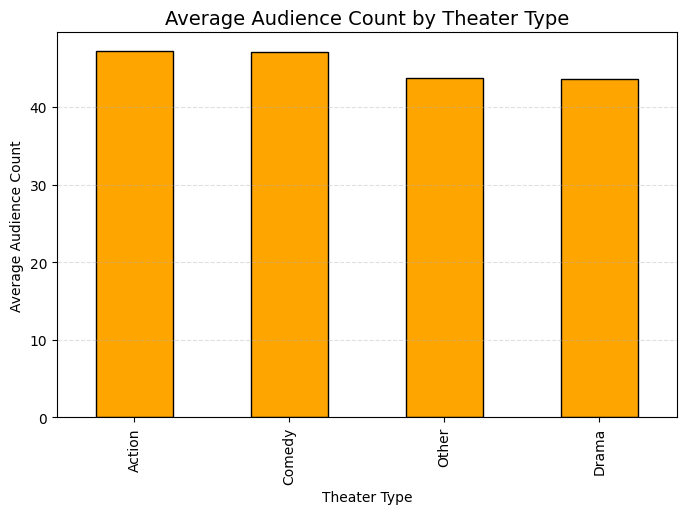

In [106]:
# Calculate and visualize average audience counts across theater types

plt.figure(figsize=(8,5))
df_booknow.groupby('theater_type')['audience_count'] \
          .mean().sort_values(ascending=False) \
          .plot(kind='bar', color='orange', edgecolor='black')

plt.title("Average Audience Count by Theater Type", fontsize=14)
plt.xlabel("Theater Type")
plt.ylabel("Average Audience Count")
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

Insights:

Action and comedy theaters have the highest average audience counts while drama and other categories have slightly lower.

this chart shows that theater type does not have a strong relationship with audience count.

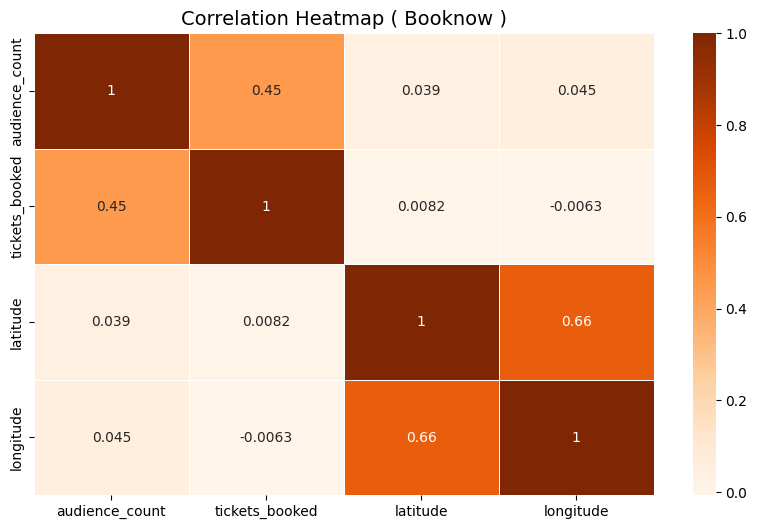

In [107]:
# Generate a correlation heatmap to check relationships between num features

import seaborn as sns


df = df_booknow.select_dtypes(include=['int64','float64'])

plt.figure(figsize=(10,6))
sns.heatmap(
    df.corr(),
    annot=True,
    cmap="Oranges",
    linewidths=0.5
)

plt.title("Correlation Heatmap ( Booknow )", fontsize=14)
plt.show()

Insights :

Audience count and tickets booked shows  moderate positive correlation of 0.45.

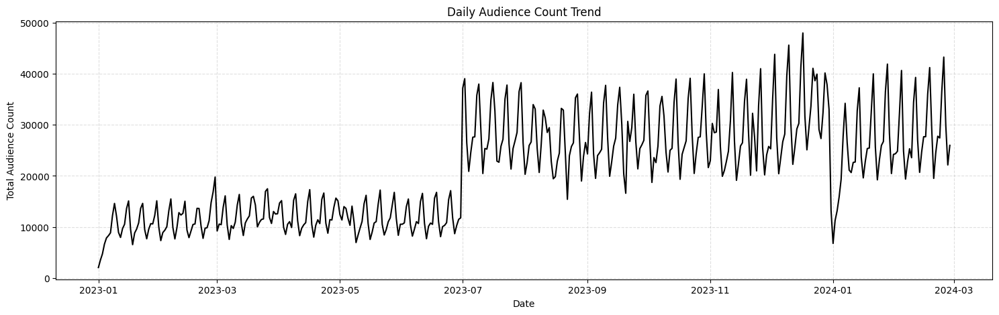

In [108]:
# Plot daily total audience counts to visualize long-term trends and seasonality

df_booknow['show_date'] = pd.to_datetime(df_booknow['show_date'])

df_daily = df_booknow.groupby('show_date')['audience_count'].sum()

plt.figure(figsize=(18,5))
plt.plot(df_daily.index, df_daily.values, color='black')
plt.title("Daily Audience Count Trend")
plt.xlabel("Date")
plt.ylabel("Total Audience Count")
plt.grid(True, linestyle='--', alpha=0.4)
plt.show()


Insights:

This plot have clear weekly seasonality as sharp peaks repeat every 7 days and matching weekend spikes.

There's a noticeable shift upward around july 2023, which shows overall audience demand increased after that period.

A clear big dip near early 2024 suggests a low-demand period.

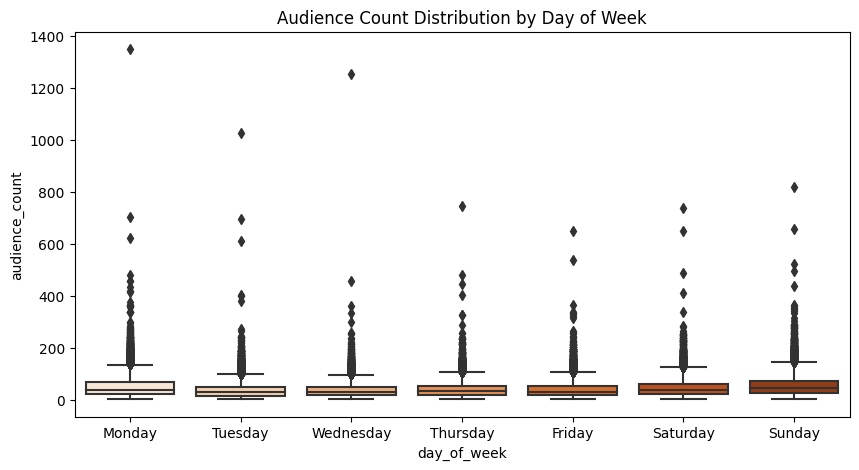

In [109]:
# audience distribution for each weekday including medians and outliers

import seaborn as sns

plt.figure(figsize=(10,5))
sns.boxplot(
    data=df_booknow,
    x='day_of_week',
    y='audience_count',
    order=["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"],
    palette="Oranges"
)
plt.title("Audience Count Distribution by Day of Week")
plt.show()


Insights:

this confirms that audience demand significantly rises on weekends, both in average and extreme values.

Friday, Saturday, and Sunday show higher medians and a much larger spread, meaning more people go to shows and variability increases.

Weekends also have many high outliers, representing blockbuster shows or special events.

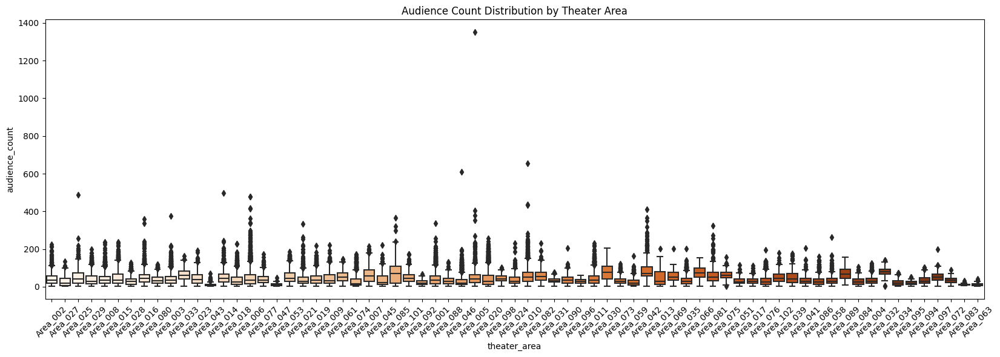

In [110]:
# Visualize audience count spread across theater areas to identify variability

plt.figure(figsize=(20,6))
sns.boxplot(
    data=df_booknow,
    x='theater_area',
    y='audience_count',
    palette="Oranges"
)
plt.title("Audience Count Distribution by Theater Area")
plt.xticks(rotation=45)
plt.show()


Insights:

Most theater areas have similar median audience levels, meaning baseline audience demand is mostly consistent across regions.

some areas show much larger spreads and many high outliers,might be indicating special events/blockbuster shows happen in only a few regions.



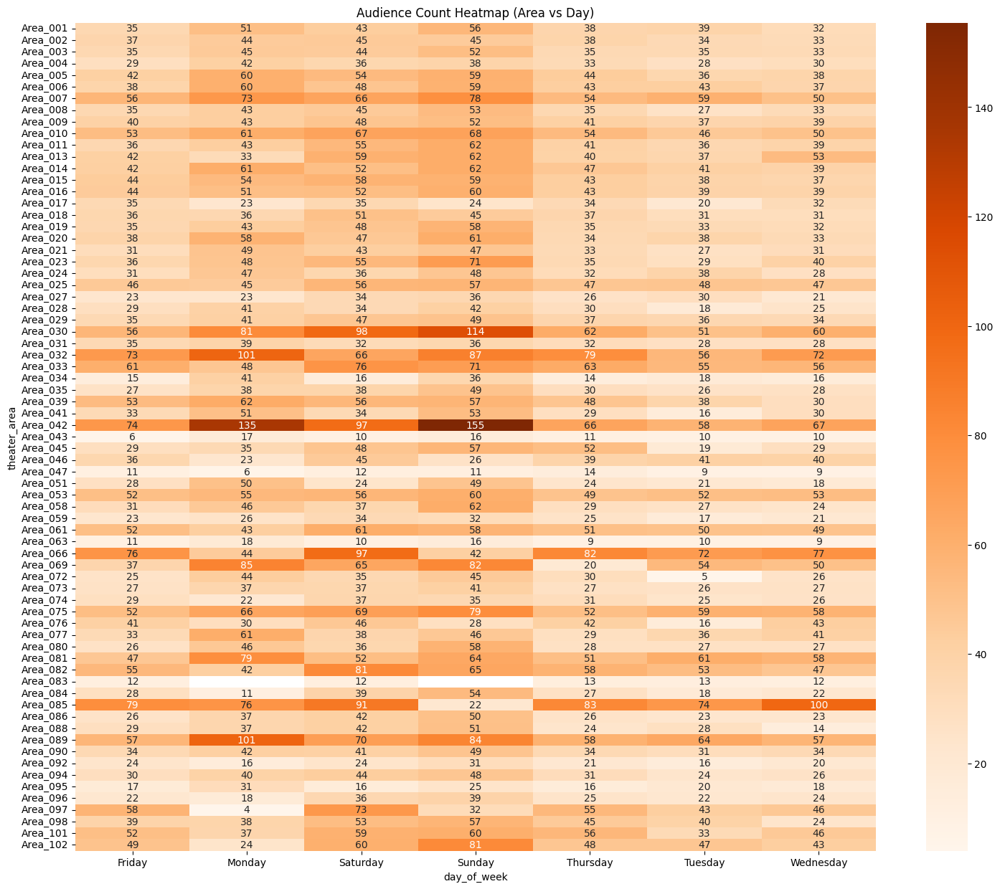

In [111]:
# heatmap showing average audience counts for each theater area across days of the week

pivot = df_booknow.pivot_table(
    values='audience_count',
    index='theater_area',
    columns='day_of_week',
    aggfunc='mean'
)

plt.figure(figsize=(18,15))
sns.heatmap(pivot, annot=True,fmt=".0f", cmap="Oranges")
plt.title("Audience Count Heatmap (Area vs Day)")
plt.show()

Insights:

The heatmap shows that almost all areas have higher audience counts on Friday, Saturday, and Sunday, confirming a strong weekend effect across regions.

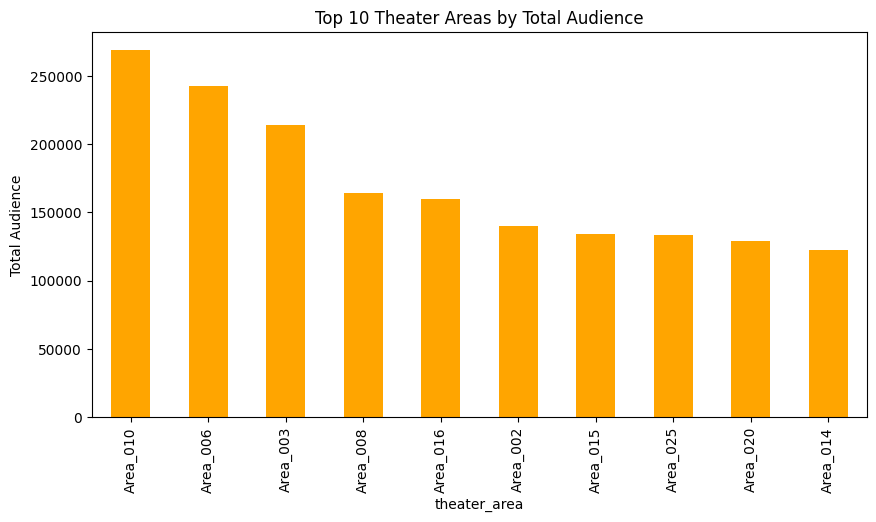

In [112]:
# Plot the top 10 theater areas based on total accumulated audience count

df_booknow.groupby('theater_area')['audience_count'] \
          .sum().sort_values(ascending=False).head(10) \
          .plot(kind='bar', figsize=(10,5), color='orange')
plt.title("Top 10 Theater Areas by Total Audience")
plt.ylabel("Total Audience")
plt.show()


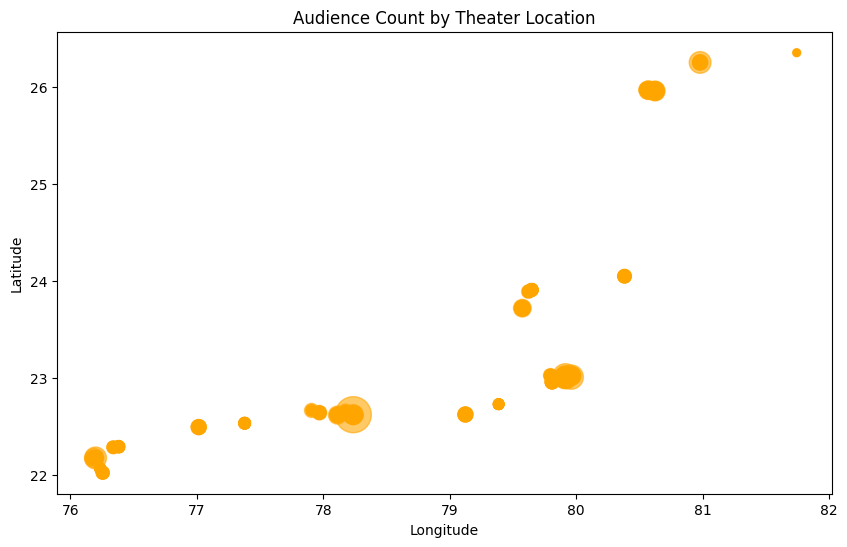

In [113]:
# Scatter plot showing theater locations with bubble size representing audience count


plt.figure(figsize=(10,6))
plt.scatter(df_booknow['longitude'], df_booknow['latitude'], 
            s=df_booknow['audience_count']/2, 
            alpha=0.6, color='orange')

plt.title("Audience Count by Theater Location")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()


Insights:

Different geographic locations show different audience sizes, visible from the varying bubble sizes.

A few clusters have noticeably larger bubbles, meaning these regions attract more viewers.

Theaters in lower-left regions have consistently smaller audiences which indicating lower demand.

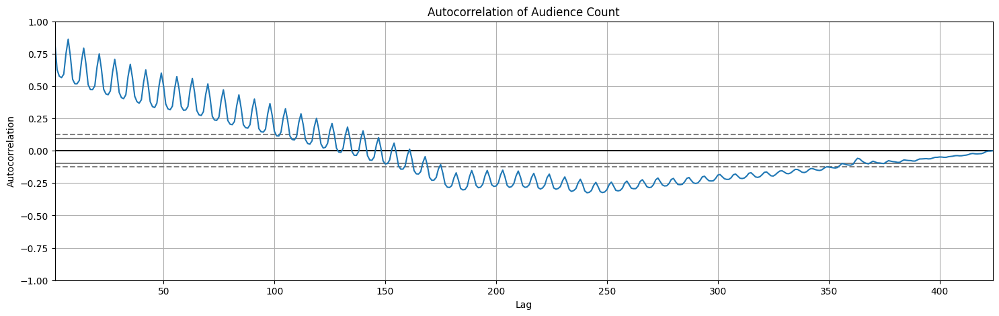

In [114]:
# Plot the autocorrelation of daily audience counts to identify repeating time patterns

from pandas.plotting import autocorrelation_plot

df_booknow['show_date'] = pd.to_datetime(df_booknow['show_date'])


df_daily = df_booknow.groupby('show_date')['audience_count'].sum()

plt.figure(figsize=(18,5))
autocorrelation_plot(df_daily)
plt.title("Autocorrelation of Audience Count")
plt.show()


Insights:

There is a very strong weekly repeating pattern peaks appear at every 7day lag which confirming clear 7-day seasonality.

So this proves that timeseries features like lag1, lag7, lag14, rolling means will be extremely powerful for prediction.

## Cinepos dataset EDA

In [115]:
# Aggregate total tickets sold per theater per day from the CinePOS booking dataset

df_cinepos_agg = df_cinePOS_booking.groupby(['cine_theater_id', 'show_date'])['tickets_sold'].sum().reset_index()

In [116]:
df_cinepos_agg

,cine_theater_id,show_date,tickets_sold
0,cinePOS_00001,2023-01-01,1
1,cinePOS_00001,2023-01-08,1
2,cinePOS_00001,2023-01-23,5
3,cinePOS_00001,2023-01-24,5
4,cinePOS_00001,2023-01-28,3
...,...,...,...
1120076,cinePOS_13157,2024-02-28,2
1120077,cinePOS_13158,2024-02-28,4
1120078,cinePOS_13159,2024-02-28,7
1120079,cinePOS_13160,2024-02-28,6


In [117]:
# Merge aggregated CinePOS ticket sales with theater metadata
df_1 = pd.merge(
    df_cinepos_agg,
    df_cinePOS_theaters,
    on='cine_theater_id',
    how='left'
)

df_2 = pd.merge(
    df_1,
    df_date_info,
    on='show_date',
    how='left'
    
)

# Merge the combined data with the theater ID relation table to align BookNow and CinePOS IDs
df_cinepos = pd.merge(
    df_2,
    df_movie_theater_id_relation,
    on='cine_theater_id',
    how='right'
)


In [118]:
df_cinepos

,cine_theater_id,show_date,tickets_sold,theater_type,theater_area,latitude,longitude,day_of_week,book_theater_id
0,cinePOS_01261,2023-01-04,11,NaN,NaN,NaN,NaN,Wednesday,book_00509
1,cinePOS_01261,2023-01-05,3,NaN,NaN,NaN,NaN,Thursday,book_00509
2,cinePOS_01261,2023-01-09,6,NaN,NaN,NaN,NaN,Monday,book_00509
3,cinePOS_01261,2023-01-11,3,NaN,NaN,NaN,NaN,Wednesday,book_00509
4,cinePOS_01261,2023-01-14,2,NaN,NaN,NaN,NaN,Saturday,book_00509
...,...,...,...,...,...,...,...,...,...
15784,cinePOS_06697,2024-01-31,2,Other,Area_148,NaN,NaN,Wednesday,book_00222
15785,cinePOS_06697,2024-02-09,20,Other,Area_148,NaN,NaN,Friday,book_00222
15786,cinePOS_06697,2024-02-10,22,Other,Area_148,NaN,NaN,Saturday,book_00222
15787,cinePOS_06697,2024-02-22,2,Other,Area_148,NaN,NaN,Thursday,book_00222


In [119]:
df_cinepos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15789 entries, 0 to 15788
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   cine_theater_id  15789 non-null  object 
 1   show_date        15789 non-null  object 
 2   tickets_sold     15789 non-null  int64  
 3   theater_type     7476 non-null   object 
 4   theater_area     7476 non-null   object 
 5   latitude         1306 non-null   float64
 6   longitude        1306 non-null   float64
 7   day_of_week      15789 non-null  object 
 8   book_theater_id  15789 non-null  object 
dtypes: float64(2), int64(1), object(6)
memory usage: 1.1+ MB


In [120]:
df_cinepos.describe()

,tickets_sold,latitude,longitude
count,15789.000000,1306.000000,1306.000000
mean,6.491861,23.497445,79.695852
std,7.267205,1.120382,0.847064
min,1.000000,22.618118,78.170501
25%,2.000000,23.009443,79.915295
50%,4.000000,23.018784,79.935314
75%,8.000000,24.048814,80.382037
max,157.000000,25.955746,80.623791


In [121]:
df_cinepos.isna().sum()

cine_theater_id        0
show_date              0
tickets_sold           0
theater_type        8313
theater_area        8313
latitude           14483
longitude          14483
day_of_week            0
book_theater_id        0
dtype: int64

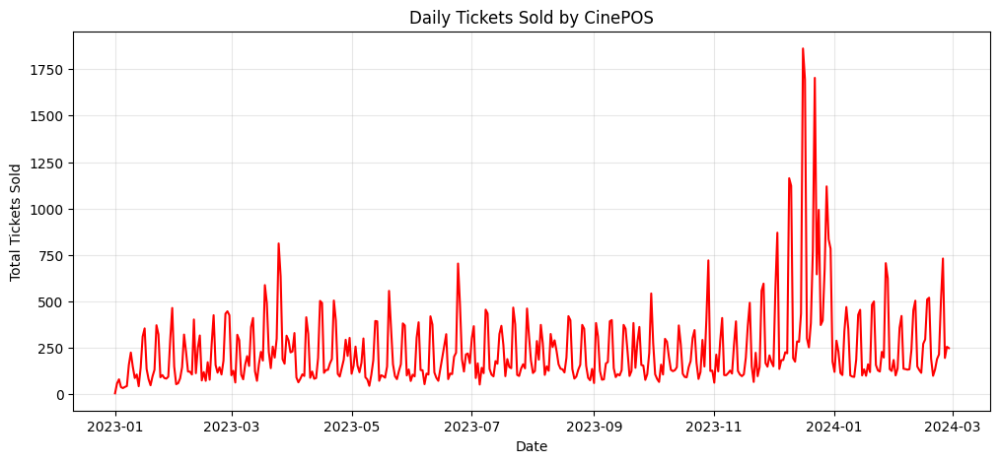

In [122]:
#the daily total number of tickets sold across all CinePOS theaters to observe sales trends over time

df_cinepos['show_date'] = pd.to_datetime(df_cinepos['show_date'])
daily_sales = df_cinepos.groupby('show_date')['tickets_sold'].sum()

plt.figure(figsize=(12,5))
plt.plot(daily_sales.index, daily_sales.values, color='red')
plt.title("Daily Tickets Sold by CinePOS")
plt.xlabel("Date")
plt.ylabel("Total Tickets Sold")
plt.grid(alpha=0.3)
plt.show()

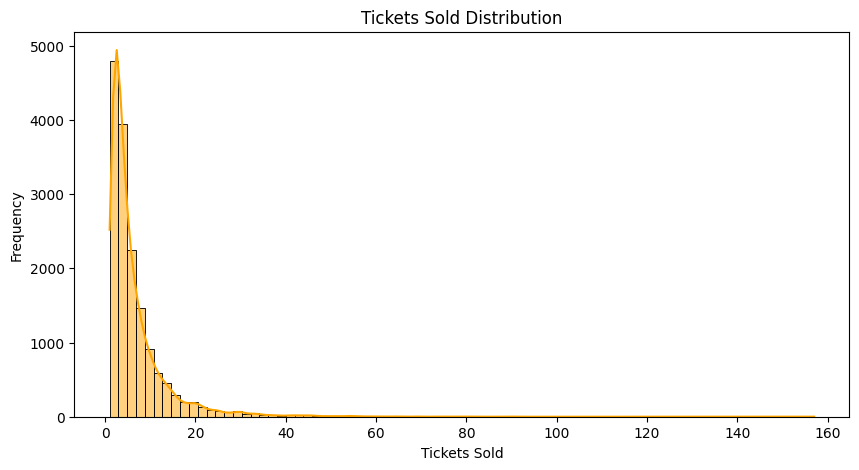

In [123]:
# Plot the distribution of tickets sold  to observe skewness and ticket volumes

plt.figure(figsize=(10,5))
sns.histplot(df_cinepos['tickets_sold'], bins=80, kde=True, color='orange')
plt.title("Tickets Sold Distribution")
plt.xlabel("Tickets Sold")
plt.ylabel("Frequency")
plt.show()

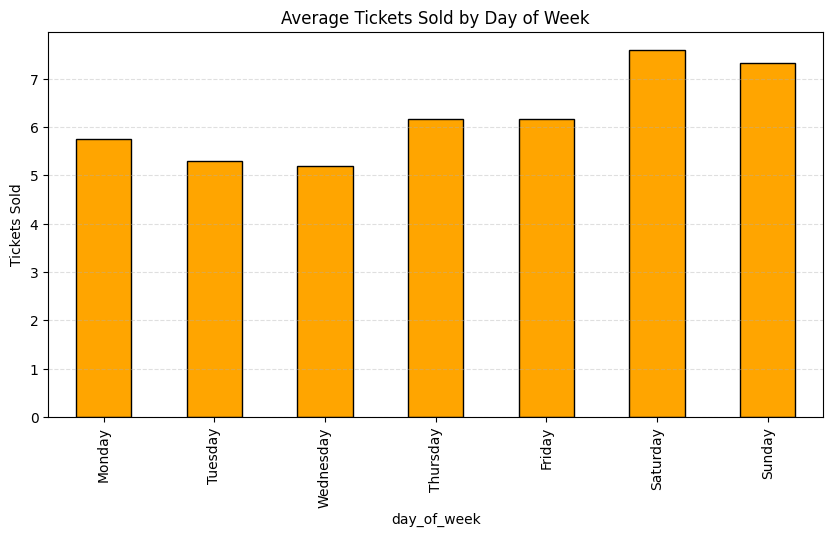

In [124]:
# visualize average tickets sold on each weekday to find weekly demand patterns


days = ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]

plt.figure(figsize=(10,5))
df_cinepos.groupby('day_of_week')['tickets_sold'].mean().loc[days].plot(
    kind='bar', color='orange', edgecolor='black')

plt.title("Average Tickets Sold by Day of Week")
plt.ylabel("Tickets Sold")
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

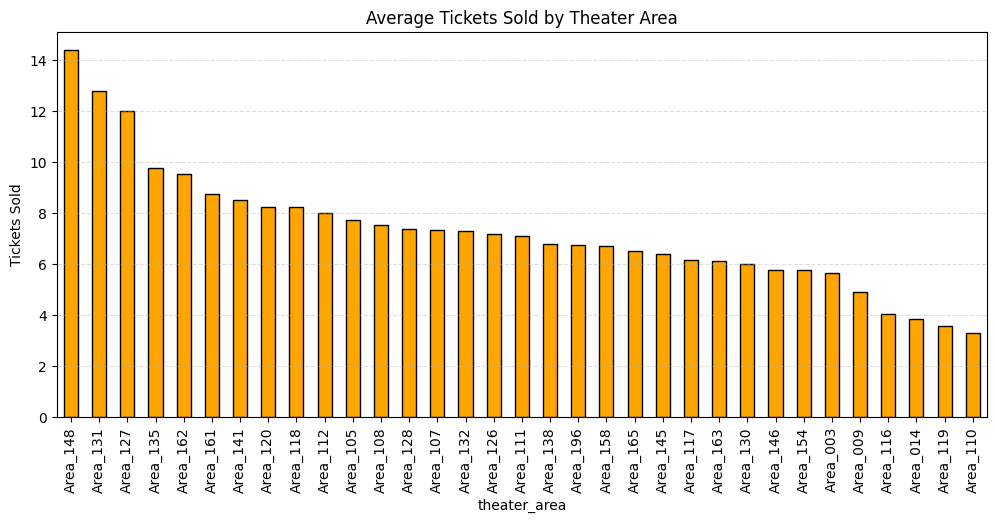

In [125]:
# Plot average tickets sold in each theater area to compare performance across regions


plt.figure(figsize=(12,5))
df_cinepos.groupby('theater_area')['tickets_sold'] \
          .mean().sort_values(ascending=False).plot(
              kind='bar',
              color='orange',
              edgecolor='black'
          )

plt.title("Average Tickets Sold by Theater Area")
plt.ylabel("Tickets Sold")
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

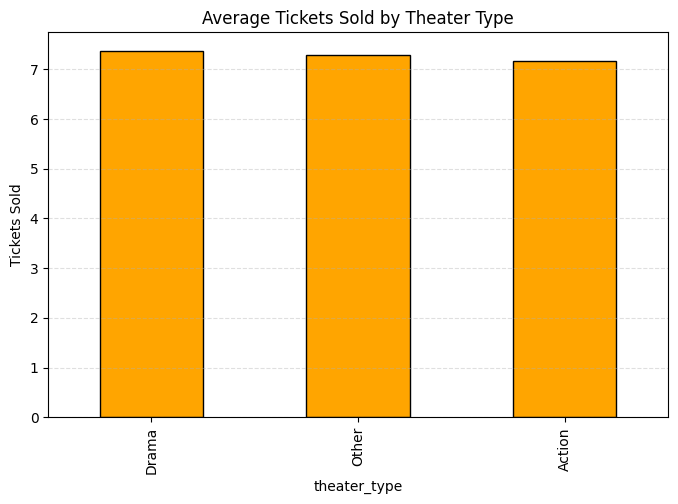

In [126]:
# Visualize how different theater types perform based on average tickets sold

plt.figure(figsize=(8,5))
df_cinepos.groupby('theater_type')['tickets_sold'] \
          .mean().sort_values(ascending=False).plot(
              kind='bar',
              color='orange',
              edgecolor='black')

plt.title("Average Tickets Sold by Theater Type")
plt.ylabel("Tickets Sold")
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

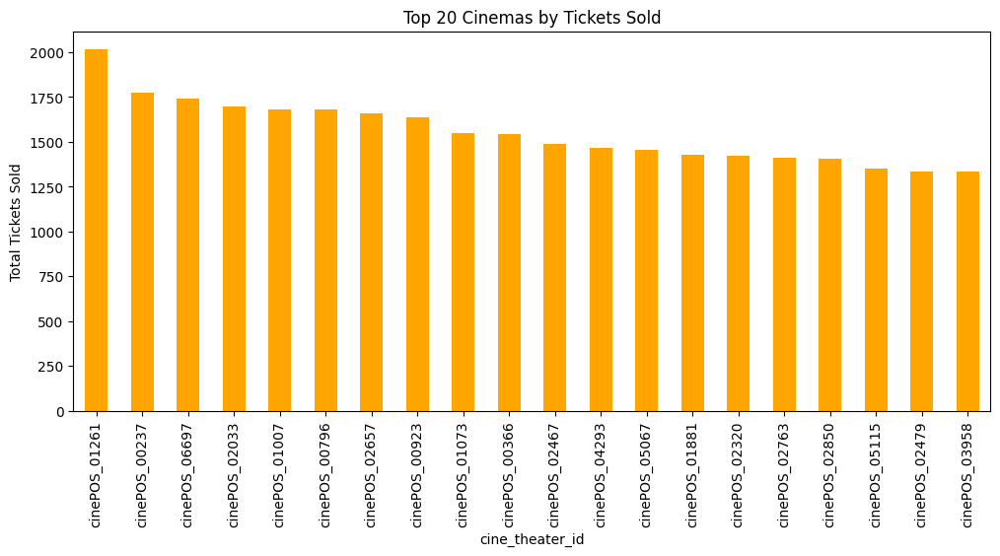

In [127]:
# Display the top 20 cinemas ranked by their total ticket sales to identify best performers

df_cinepos.groupby('cine_theater_id')['tickets_sold'] \
          .sum().sort_values(ascending=False).head(20).plot(
              kind='bar',
              figsize=(12,5),
              color='orange'
          )

plt.title("Top 20 Cinemas by Tickets Sold")
plt.ylabel("Total Tickets Sold")
plt.show()

In [128]:
# Merge BookNow data with CinePOS ticket sales and theater metadata using theater ID and show date

df_booknow['show_date'] = pd.to_datetime(df_booknow['show_date'])
df_cinepos['show_date'] = pd.to_datetime(df_cinepos['show_date'])

df_merged = pd.merge(
    df_booknow,
    df_cinepos[['book_theater_id', 'show_date', 'theater_type', 'theater_area',
                'latitude', 'longitude', 'tickets_sold']],
    on=['book_theater_id', 'show_date'],
    how='left'
)


In [129]:
# Fill missing merged values by using CinePOS data first and falling back to BookNow's original values

cols_to_fill = ['theater_type', 'theater_area', 'latitude', 'longitude']

for col in cols_to_fill:
    df_merged[col] = df_merged[col + '_y'].fillna(df_merged[col + '_x'])


In [130]:
df_merged = df_merged.drop(columns=[
    'theater_type_x','theater_type_y',
    'theater_area_x','theater_area_y',
    'latitude_x','latitude_y',
    'longitude_x','longitude_y'
])


In [131]:
df_merged

,book_theater_id,show_date,audience_count,tickets_booked,day_of_week,tickets_sold,theater_type,theater_area,latitude,longitude
0,book_00001,2023-01-13,50,NaN,Friday,NaN,Drama,Area_002,23.00441,79.934515
1,book_00001,2023-01-14,64,NaN,Saturday,NaN,Drama,Area_002,23.00441,79.934515
2,book_00001,2023-01-15,58,NaN,Sunday,NaN,Drama,Area_002,23.00441,79.934515
3,book_00001,2023-01-16,44,NaN,Monday,NaN,Drama,Area_002,23.00441,79.934515
4,book_00001,2023-01-18,12,NaN,Wednesday,NaN,Drama,Area_002,23.00441,79.934515
...,...,...,...,...,...,...,...,...,...,...
214041,book_00829,2024-02-23,16,NaN,Friday,NaN,NaN,NaN,NaN,NaN
214042,book_00829,2024-02-24,8,NaN,Saturday,NaN,NaN,NaN,NaN,NaN
214043,book_00829,2024-02-25,16,NaN,Sunday,NaN,NaN,NaN,NaN,NaN
214044,book_00829,2024-02-27,16,NaN,Tuesday,NaN,NaN,NaN,NaN,NaN


In [132]:
df_merged.isna().sum()

book_theater_id         0
show_date               0
audience_count          0
tickets_booked     193005
day_of_week             0
tickets_sold       202896
theater_type       132093
theater_area       132093
latitude           133584
longitude          133584
dtype: int64

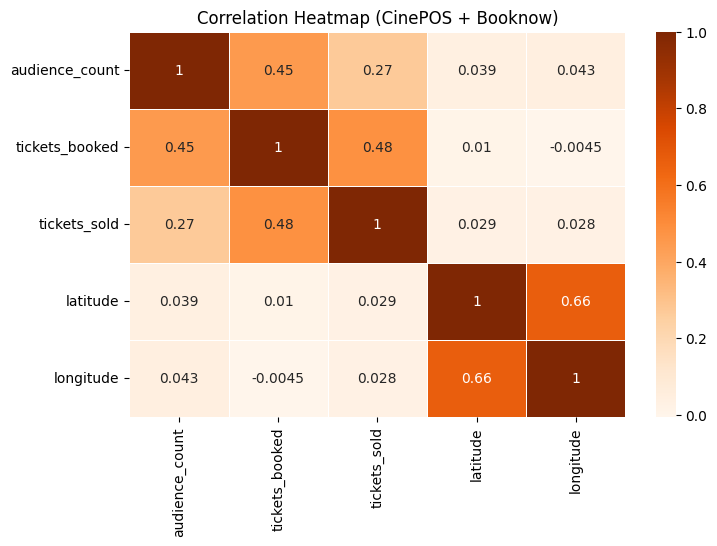

In [133]:
numeric_df = df_merged.select_dtypes(include=['int64','float64'])

plt.figure(figsize=(8,5))
sns.heatmap(numeric_df.corr(), annot=True, cmap="Oranges", linewidths=0.5)
plt.title("Correlation Heatmap (CinePOS + Booknow)")
plt.show()

Insights:

Audience count has a moderate correlation  with both tickets_booked and tickets_sold, meaning booking numbers do influence final audience but not perfectly

# 3. Preparing Train Dataset

## 3.1 Data Cleaning and Merging

In [134]:
# Merge visits with theater metadata
df_1 = df_booknow_visits.merge(
    df_booknow_theaters,
    on="book_theater_id",
    how="left"
)

#  Merge with date information
df = df_1.merge(
    df_date_info,
    on="show_date",
    how="left"
)


# Final sort for proper time series ordering
df = df.sort_values(["book_theater_id", "show_date"]).reset_index(drop=True)

In [135]:
df

,book_theater_id,show_date,audience_count,theater_type,theater_area,latitude,longitude,day_of_week
0,book_00001,2023-01-13,50,Drama,Area_002,23.00441,79.934515,Friday
1,book_00001,2023-01-14,64,Drama,Area_002,23.00441,79.934515,Saturday
2,book_00001,2023-01-15,58,Drama,Area_002,23.00441,79.934515,Sunday
3,book_00001,2023-01-16,44,Drama,Area_002,23.00441,79.934515,Monday
4,book_00001,2023-01-18,12,Drama,Area_002,23.00441,79.934515,Wednesday
...,...,...,...,...,...,...,...,...
214041,book_00829,2024-02-23,16,NaN,NaN,NaN,NaN,Friday
214042,book_00829,2024-02-24,8,NaN,NaN,NaN,NaN,Saturday
214043,book_00829,2024-02-25,16,NaN,NaN,NaN,NaN,Sunday
214044,book_00829,2024-02-27,16,NaN,NaN,NaN,NaN,Tuesday


## 3.2 Encoding Category Values

In [136]:
from sklearn.preprocessing import LabelEncoder

# fill nan values in theater area column with unknown
df["theater_area"] = df["theater_area"].fillna("Unknown")

area_encoder = LabelEncoder()
theater_encoder = LabelEncoder()

# Encode theater_area
df["theater_area_enc"] = area_encoder.fit_transform(df["theater_area"].astype(str))

# Encode book_theater_id
df["theater_id_enc"] = theater_encoder.fit_transform(df["book_theater_id"].astype(str))


## 3.3 Feature engineering

### 3.3.1 Basic Time Features

In [137]:
import holidays

df["show_date"] = pd.to_datetime(df["show_date"], errors="coerce")

df["dow"] = df["show_date"].dt.weekday        #  day of the week like 0 = Monday, 6 = Sunday
df["month"] = df["show_date"].dt.month        #  month number (1–12)
df["quarter"] = df["show_date"].dt.quarter   # quarter of the year (1–4)
df["day"] = df["show_date"].dt.day           # day of the month 1–31
df["week_of_month"] = ((df["show_date"].dt.day - 1) // 7 + 1) #  week number within the month 1st week, 2nd week 
df["is_weekend"] = df["dow"].isin([5,6]).astype(int)  # 1 for Saturday/Sunday, otherwise 0

hol = holidays.country_holidays("IN")
df["is_holiday"] = df["show_date"].dt.date.apply(lambda x: x in hol).astype(int) #  holiday in India: 1 for holiday, 0 otherwise

### 3.3.2 Create lag features

In [138]:
lag_list = [1, 3, 7, 14, 21]

for l in lag_list:
    df[f"lag_{l}"] = (
        df.groupby("book_theater_id")["audience_count"].shift(l)
    )

### 3.3.3 Create Rolling mean/std feature

In [139]:
rolling_windows = [7, 14, 21]

for w in rolling_windows:
    
    df[f"roll_mean_{w}"] = (
        df.groupby("book_theater_id")["audience_count"]
          .shift(1).rolling(w, min_periods=w//3).mean()
    )
    
    
    df[f"roll_std_{w}"] = (
        df.groupby("book_theater_id")["audience_count"]
          .shift(1).rolling(w, min_periods=w//3).std()
    )


### 3.3.4 Create Exponentially Weighted Means (EWMs)

In [140]:
ewm_spans = [7, 14, 30]

for span in ewm_spans:
    df[f"ewm_{span}"] = (
        df.groupby("book_theater_id")["audience_count"]
          .apply(lambda s: s.shift(1).ewm(span=span, adjust=False).mean())
          .reset_index(level=0, drop=True)
    )


## 3.4 Generated features

In [141]:
df

,book_theater_id,show_date,audience_count,theater_type,theater_area,latitude,longitude,day_of_week,theater_area_enc,theater_id_enc,...,lag_21,roll_mean_7,roll_std_7,roll_mean_14,roll_std_14,roll_mean_21,roll_std_21,ewm_7,ewm_14,ewm_30
0,book_00001,2023-01-13,50,Drama,Area_002,23.00441,79.934515,Friday,1,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,book_00001,2023-01-14,64,Drama,Area_002,23.00441,79.934515,Saturday,1,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.000000,50.000000,50.000000
2,book_00001,2023-01-15,58,Drama,Area_002,23.00441,79.934515,Sunday,1,0,...,NaN,57.000000,9.899495,NaN,NaN,NaN,NaN,53.500000,51.866667,50.903226
3,book_00001,2023-01-16,44,Drama,Area_002,23.00441,79.934515,Monday,1,0,...,NaN,57.333333,7.023769,NaN,NaN,NaN,NaN,54.625000,52.684444,51.361082
4,book_00001,2023-01-18,12,Drama,Area_002,23.00441,79.934515,Wednesday,1,0,...,NaN,54.000000,8.793937,54.000000,8.793937,NaN,NaN,51.968750,51.526519,50.886174
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214041,book_00829,2024-02-23,16,NaN,Unknown,NaN,NaN,Friday,71,825,...,14.0,10.571429,4.577377,11.142857,3.977961,11.523810,4.094131,11.894878,11.546608,11.789158
214042,book_00829,2024-02-24,8,NaN,Unknown,NaN,NaN,Saturday,71,825,...,16.0,10.857143,4.879500,12.000000,3.594868,11.619048,4.177035,12.921158,12.140394,12.060826
214043,book_00829,2024-02-25,16,NaN,Unknown,NaN,NaN,Sunday,71,825,...,16.0,11.428571,4.117327,11.714286,3.750458,11.238095,4.121951,11.690869,11.588341,11.798837
214044,book_00829,2024-02-27,16,NaN,Unknown,NaN,NaN,Tuesday,71,825,...,8.0,12.857143,3.625308,12.000000,3.922323,11.238095,4.121951,12.768151,12.176563,12.069880


In [142]:
time_f = [
    # Short lags
    "lag_1", "lag_3",

    # long lags
    "lag_7", "lag_14", "lag_21",

    # Rolling means
    "roll_mean_7", "roll_mean_14", "roll_mean_21",

    # Rolling std
    "roll_std_7", "roll_std_14",

    # Exponential moving averages
    "ewm_7", "ewm_14",
]

other_f = [
    "theater_id_enc",
    "theater_area_enc",
    "dow",
    "is_weekend",
    "month",
    "is_holiday",
    "quarter",
    "day",
    "week_of_month",
]

FEATURES = time_f + other_f
TARGET = "audience_count"

## 3.5 Handling Missing Values

In [143]:
df[FEATURES].isna().sum()

lag_1                 826
lag_3                2475
lag_7                5771
lag_14              11539
lag_21              17299
roll_mean_7             2
roll_mean_14            4
roll_mean_21            7
roll_std_7              2
roll_std_14             4
ewm_7                 826
ewm_14                826
theater_id_enc          0
theater_area_enc        0
dow                     0
is_weekend              0
month                   0
is_holiday              0
quarter                 0
day                     0
week_of_month           0
dtype: int64

In [144]:
# Identify all time series feature columns
ts_features = [
    c for c in df.columns 
    if c.startswith(("lag_", "roll_", "ewm_"))
]

# Compute fallback median values for each time feature
fallbacks = {
    c: df[c].median(skipna=True) 
    for c in ts_features
}

# Fill missing values per theater if still remaining then use global fallback
for c in ts_features:
    
    # Backfill within each theater (preserves time-series logic)
    df[c] = df.groupby("book_theater_id")[c].transform(
        lambda s: s.bfill()
    )
    
    # Fill remaining NaNs with global medians
    df[c] = df[c].fillna(fallbacks[c])

# 4. Train / validation split

In [145]:
#time-based validation split (last 2 months)


last_date = df["show_date"].max()
cutoff = last_date - pd.Timedelta(days=60)

train_df = df[df["show_date"] < cutoff]
valid_df = df[df["show_date"] >= cutoff]

X_train = train_df[FEATURES]
y_train = train_df[TARGET]

X_valid = valid_df[FEATURES]
y_valid = valid_df[TARGET]


print("Train rows:", len(X_train), "Validation rows:", len(X_valid))


Train rows: 173649 Validation rows: 40397


# 5. Model Building

In [146]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

from sklearn.metrics import mean_absolute_error, r2_score


from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor

from sklearn.model_selection import RandomizedSearchCV, TimeSeriesSplit

## 5.1 Ridge Regressor (Baseline)

In [147]:
ridge = Pipeline([
    ("model", Ridge())
])

ridge.fit(X_train, y_train)
pred_ridge = ridge.predict(X_valid)

mae_ridge = mean_absolute_error(y_valid, pred_ridge)
r2_ridge   = r2_score(y_valid, pred_ridge)

print("Ridge MAE:", round(mae_ridge, 4))
print("Ridge R2:", round(r2_ridge, 4))

# Ridge MAE: 15.5414
# Ridge R2: 0.4853

Ridge MAE: 15.5414
Ridge R2: 0.4853


## 5.2 RandomForest Regressor

In [148]:
# Random Forest pipeline
rf_base = Pipeline([
    ("model", RandomForestRegressor(
        n_estimators=300,
        max_depth=None,
        min_samples_split=2,
        min_samples_leaf=1,
        max_features="auto",
        bootstrap=True,
        random_state=42,
        n_jobs=-1
    ))
])

# Train the model
rf_base.fit(X_train, y_train)

# Predict
pred_rf_base = rf_base.predict(X_valid)

# Metrics
mae_rf_base = mean_absolute_error(y_valid, pred_rf_base)
r2_rf_base   = r2_score(y_valid, pred_rf_base)

print("Random Forest MAE:", round(mae_rf_base, 4))
print("Random Forest R2:", round(r2_rf_base, 4))


Random Forest MAE: 15.9978
Random Forest R2: 0.4532


## 5.3 XGBoost Regressor

In [149]:
xgb_base = Pipeline([
    ("model", XGBRegressor(
        n_estimators=800,
        learning_rate=0.04,
        max_depth=6,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42,
        n_jobs=-1,
        tree_method="hist"
    ))
])

xgb_base.fit(X_train, y_train)
pred_xgb_base = xgb_base.predict(X_valid)

mae_xgb_base = mean_absolute_error(y_valid, pred_xgb_base)
r2_xgb_base   = r2_score(y_valid, pred_xgb_base)

print("XGB  MAE:", round(mae_xgb_base, 4))
print("XGB  R2:", round(r2_xgb_base, 4))

# XGB  MAE: 15.616
# XGB  R2: 0.4861

XGB  MAE: 15.616
XGB  R2: 0.4861


## 5.4 Lgbm Regressor

In [150]:
lgb_base = Pipeline([
    ("model", LGBMRegressor(
        n_estimators=1500,
        learning_rate=0.01,
        random_state=42
    ))
])

lgb_base.fit(X_train, y_train)
pred_lgb_base = lgb_base.predict(X_valid)

mae_lgb_base = mean_absolute_error(y_valid, pred_lgb_base)
r2_lgb_base   = r2_score(y_valid, pred_lgb_base)

print("LGB MAE:", round(mae_lgb_base, 4))
print("LGB R2:", round(r2_lgb_base, 4))

# LGB MAE: 15.6617
# LGB R2: 0.4871

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010829 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2927
[LightGBM] [Info] Number of data points in the train set: 173649, number of used features: 21
[LightGBM] [Info] Start training from score 41.952502
LGB MAE: 15.6617
LGB R2: 0.4871


# 6. hyperparameter tuning

## 6.1 Tuned XGBoost

In [151]:
# # Hyper parameter tuning XGBoost using Randomized Search

tscv = TimeSeriesSplit(n_splits=3)

param_grid = {
    "model__n_estimators": [600, 900, 1200, 1500],
    "model__learning_rate": [0.01, 0.02, 0.03],
    "model__max_depth": [4, 5, 6],
    "model__subsample": [0.6, 0.7, 0.8, 1.0],
    "model__colsample_bytree": [0.6, 0.8, 1.0],
    "model__gamma": [0, 1, 5],
}

xgb_tuned = RandomizedSearchCV(
    xgb_base,
    param_grid,
    cv=tscv,
    scoring="r2",      
    n_iter=40,
    random_state=42,
    verbose=1
)

xgb_tuned.fit(X_train, y_train)

print("Best XGB params:", xgb_tuned.best_params_)

pred_xgb_tuned = xgb_tuned.predict(X_valid)

mae_xgb_tuned = mean_absolute_error(y_valid, pred_xgb_tuned)
r2_xgb_tuned   = r2_score(y_valid, pred_xgb_tuned)

print("XGB Tuned MAE:", round(mae_xgb_tuned, 4))
print("XGB Tuned R2:", round(r2_xgb_tuned, 4))

# # Fitting 3 folds for each of 40 candidates, totalling 120 fits
# # Best XGB params: {'model__subsample': 0.6, 'model__n_estimators': 600, 'model__max_depth': 5, 'model__learning_rate': 0.01, 'model__gamma': 5, 'model__colsample_bytree': 0.8}
# # XGB Tuned MAE: 15.5737
# # XGB Tuned R2: 0.4914

Fitting 3 folds for each of 40 candidates, totalling 120 fits
Best XGB params: {'model__subsample': 0.6, 'model__n_estimators': 600, 'model__max_depth': 5, 'model__learning_rate': 0.01, 'model__gamma': 5, 'model__colsample_bytree': 0.8}
XGB Tuned MAE: 15.5737
XGB Tuned R2: 0.4914


## 6.2 Tuned Lgbm

In [152]:
# # Hyper parameter tuning Lgbm using Randomized Search

param_grid = {
    "model__n_estimators": [1500, 2500, 3000],
    "model__learning_rate": [0.005, 0.01, 0.02],
    "model__num_leaves": [31, 50, 80],
    "model__feature_fraction": [0.7, 0.8, 1.0],
    "model__bagging_fraction": [0.7, 0.8, 1.0],
    "model__bagging_freq": [1],
    "model__min_data_in_leaf": [20, 50, 100],
}

lgb_tuned = RandomizedSearchCV(
    lgb_base,
    param_grid,
    cv=tscv,
    scoring="r2",       
    n_iter=40,
    random_state=42,
    verbose=1
)

lgb_tuned.fit(X_train, y_train)

print("Best LGB params:", lgb_tuned.best_params_)

pred_lgb_tuned = lgb_tuned.predict(X_valid)

mae_lgb_tuned = mean_absolute_error(y_valid, pred_lgb_tuned)
r2_lgb_tuned   = r2_score(y_valid, pred_lgb_tuned)

print("LGB Tuned MAE:", round(mae_lgb_tuned, 4))
print("LGB Tuned R2:", round(r2_lgb_tuned, 4))

# # Best LGB params: {'model__num_leaves': 80, 
# #                   'model__n_estimators': 1500, 
# #                   'model__min_data_in_leaf': 100, 
# #                   'model__learning_rate': 0.005, 
# #                   'model__feature_fraction': 0.8, 
# #                   'model__bagging_freq': 1, 
# #                   'model__bagging_fraction': 0.7}

# # LGB Tuned MAE: 15.5269
# # LGB Tuned R2: 0.4943

Fitting 3 folds for each of 40 candidates, totalling 120 fits
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=

# 7 Model Performance Comparision

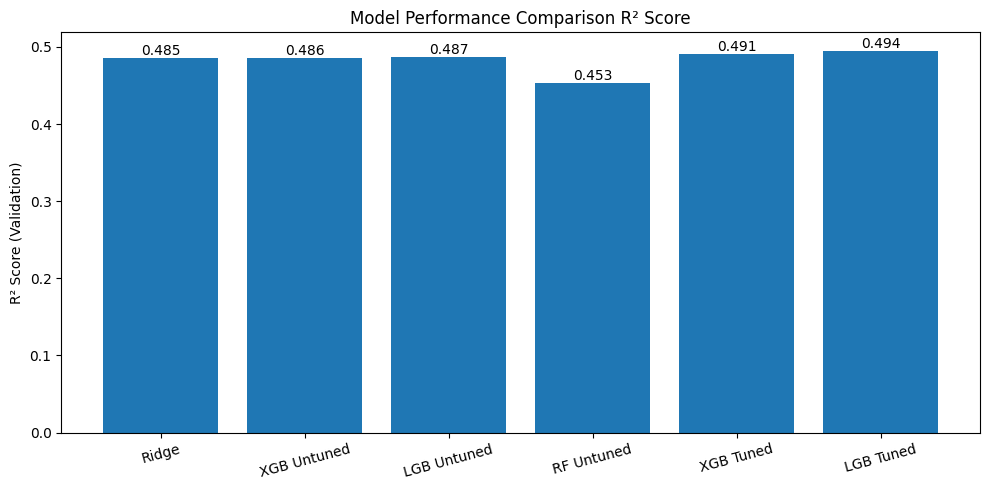

In [153]:
names = ["Ridge", "XGB Untuned", "LGB Untuned", "RF Untuned", "XGB Tuned", "LGB Tuned"]
scores = [r2_ridge, r2_xgb_base, r2_lgb_base, r2_rf_base, r2_xgb_tuned, r2_lgb_tuned]

plt.figure(figsize=(10,5))
bars = plt.bar(names, scores)
plt.ylabel("R² Score (Validation)")
plt.title("Model Performance Comparison R² Score")


# Add score labels above bars
for bar, score in zip(bars, scores):
    plt.text(
        bar.get_x() + bar.get_width()/2,
        bar.get_height(),
        f"{score:.3f}",
        ha="center",
        va="bottom"
    )

plt.xticks(rotation=15)
plt.tight_layout()
plt.show()


## 7.1 Training best performing model on full train set

In [154]:
lgb_final = Pipeline([
    ("model", LGBMRegressor(
        num_leaves=80,
        n_estimators=1500,
        learning_rate=0.005,
        min_data_in_leaf=100,
        feature_fraction=0.8,     
        bagging_fraction=0.7,      
        bagging_freq=1,                       
        random_state=42,
        n_jobs=-1,
    ))
])


In [155]:
X = df[FEATURES]
y = df[TARGET]

In [156]:
lgb_final.fit(X,y)


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Info] Auto-choosing row-wise multi-threadi

Pipeline(steps=[('model',
                 LGBMRegressor(bagging_fraction=0.7, bagging_freq=1,
                               feature_fraction=0.8, learning_rate=0.005,
                               min_data_in_leaf=100, n_estimators=1500,
                               n_jobs=-1, num_leaves=80, random_state=42))])

# 8. Prepare test dataset

## 8.1 Load test data

In [157]:
test = df_sample.copy()


test[["book_theater_id","show_date"]] = test["ID"].str.extract(r"(book_\d+)_(\d{4}-\d{2}-\d{2})")
test["show_date"] = pd.to_datetime(test["show_date"])
df_date_info["show_date"] = pd.to_datetime(df_date_info["show_date"])

test = test.merge(df_booknow_theaters, on="book_theater_id", how="left")
test = test.merge(df_date_info,      on="show_date",      how="left")

## 8.2 Encoding Catageorical column

In [158]:
# Fill missing theater area
test["theater_area"]    = test["theater_area"].fillna("Unknown")

# Encode theater_area for TEST using train-fitted encoder
test["theater_area_enc"] = area_encoder.transform(test["theater_area"].astype(str))



# Encode theater ID for TEST using train fitted encoder
seen = set(theater_encoder.classes_)

enc_values = []
for x in test["book_theater_id"].astype(str):
    if x in seen:
        enc_values.append(theater_encoder.transform([x])[0])
    else:
        enc_values.append(-1) # if not found in seen then repalce it by -1 bcz some theater ids arent seen during train fitting ,like book_00040

test["theater_id_enc"] = enc_values

## 8.3 add basic time features to trainset

In [159]:

# Basic time features from the show date
test["dow"] = test["show_date"].dt.weekday
test["is_weekend"] = test["dow"].isin([5,6]).astype(int)
test["month"] = test["show_date"].dt.month
test["quarter"] = test["show_date"].dt.quarter
test["day"] = test["show_date"].dt.day
test["week_of_month"] = ((test["show_date"].dt.day - 1)//7 + 1)
test["is_holiday"] = test["show_date"].dt.date.apply(lambda x: x in hol).astype(int)

In [160]:
test

,ID,audience_count,book_theater_id,show_date,theater_type,theater_area,latitude,longitude,day_of_week,theater_area_enc,theater_id_enc,dow,is_weekend,month,quarter,day,week_of_month,is_holiday
0,book_00001_2024-03-01,0,book_00001,2024-03-01,Drama,Area_002,23.00441,79.934515,Friday,1,0,4,0,3,1,1,1,0
1,book_00001_2024-03-02,0,book_00001,2024-03-02,Drama,Area_002,23.00441,79.934515,Saturday,1,0,5,1,3,1,2,1,0
2,book_00001_2024-03-03,0,book_00001,2024-03-03,Drama,Area_002,23.00441,79.934515,Sunday,1,0,6,1,3,1,3,1,0
3,book_00001_2024-03-04,0,book_00001,2024-03-04,Drama,Area_002,23.00441,79.934515,Monday,1,0,0,0,3,1,4,1,0
4,book_00001_2024-03-06,0,book_00001,2024-03-06,Drama,Area_002,23.00441,79.934515,Wednesday,1,0,2,0,3,1,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38057,book_00829_2024-04-18,0,book_00829,2024-04-18,NaN,Unknown,NaN,NaN,Thursday,71,825,3,0,4,2,18,3,0
38058,book_00829_2024-04-19,0,book_00829,2024-04-19,NaN,Unknown,NaN,NaN,Friday,71,825,4,0,4,2,19,3,0
38059,book_00829_2024-04-20,0,book_00829,2024-04-20,NaN,Unknown,NaN,NaN,Saturday,71,825,5,1,4,2,20,3,0
38060,book_00829_2024-04-21,0,book_00829,2024-04-21,NaN,Unknown,NaN,NaN,Sunday,71,825,6,1,4,2,21,3,1


## 7.1 Build history for autoregression

In [161]:
history = {}
global_med = df["audience_count"].median()

for tid, g in df.groupby("book_theater_id"):
    vals = g["audience_count"].dropna().tolist()
    
    if len(vals) > 0:
        history[tid] = vals[-60:]   # last 60 historical values
    else:
        history[tid] = [global_med] * 60   # if no history


## 7.2 Iterative forecasting

In [162]:
best_model = lgb_final

In [163]:
preds = []

for idx, row in test.iterrows():


    # History for this theater

    tid = row["book_theater_id"]

    if tid in history:
        hist = history[tid].copy()
    else:
        hist = [global_med] * 60



    # Lag features

    # lag_1
    lag_1 = hist[-1]

    # lag_3
    if len(hist) >= 3:
        lag_3 = hist[-3]
    else:
        lag_3 = lag_1

    # lag_7
    if len(hist) >= 7:
        lag_7 = hist[-7]
    else:
        lag_7 = lag_1

    # lag_14
    if len(hist) >= 14:
        lag_14 = hist[-14]
    else:
        lag_14 = lag_7

    # lag_21
    if len(hist) >= 21:
        lag_21 = hist[-21]
    else:
        lag_21 = lag_14



    # Rolling means

    if len(hist) >= 7:
        roll_mean_7 = np.mean(hist[-7:])
    else:
        roll_mean_7 = lag_1

    if len(hist) >= 14:
        roll_mean_14 = np.mean(hist[-14:])
    else:
        roll_mean_14 = lag_1

    if len(hist) >= 21:
        roll_mean_21 = np.mean(hist[-21:])
    else:
        roll_mean_21 = lag_1



    #  Rolling std

    if len(hist) >= 7:
        roll_std_7 = np.std(hist[-7:])
    else:
        roll_std_7 = 0

    if len(hist) >= 14:
        roll_std_14 = np.std(hist[-14:])
    else:
        roll_std_14 = 0



    # EWM features

    hist_series = pd.Series(hist)

    ewm_7  = hist_series.ewm(span=7,  adjust=False).mean().iloc[-1]
    ewm_14 = hist_series.ewm(span=14, adjust=False).mean().iloc[-1]
    ewm_30 = hist_series.ewm(span=30, adjust=False).mean().iloc[-1]



    # Build feature row

    feat = pd.DataFrame([{
        "lag_1": lag_1,
        "lag_3": lag_3,
        "lag_7": lag_7,
        "lag_14": lag_14,
        "lag_21": lag_21,

        "roll_mean_7": roll_mean_7,
        "roll_mean_14": roll_mean_14,
        "roll_mean_21": roll_mean_21,

        "roll_std_7": roll_std_7,
        "roll_std_14": roll_std_14,

        "ewm_7": ewm_7,
        "ewm_14": ewm_14,
        "ewm_30": ewm_30,

        "theater_id_enc":   row["theater_id_enc"],
        "theater_area_enc": row["theater_area_enc"],
        "dow":              row["dow"],
        "is_weekend":       row["is_weekend"],
        "month":            row["month"],
        "is_holiday":       row["is_holiday"],
        "quarter":          row["quarter"],
        "day":              row["day"],
        "week_of_month":    row["week_of_month"],
    }])

    feat = feat[FEATURES]



    # Predict

    pred = best_model.predict(feat)[0]

    if pred < 0:
        pred = 0

    preds.append(pred)



    # Update history

    hist.append(pred)
    history[tid] = hist[-60:]


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=100, min_

In [164]:
# Final submission

test["audience_count"] = preds
submission = test[["ID", "audience_count"]]
submission.to_csv("submission.csv", index=False)

print("submission.csv saved with", len(submission), "rows.")

submission.csv saved with 38062 rows.


In [165]:
submission.describe()

,audience_count
count,38062.000000
mean,42.402124
std,22.046360
min,5.262471
25%,24.801222
50%,38.467080
75%,57.064437
max,146.868772
